In [29]:
import torch
from torch import nn

# Note: this notebook requires torch >= 1.10.0
print(torch.__version__)

# Setup device-agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

2.1.1+cu118


'cuda'

In [30]:
import requests
import zipfile
from pathlib import Path
import os

# Setup path to data folder
data_path = Path("data/")
#image_path = data_path / "pizza_steak_sushi"
image_path = Path('Warriors-vs-Cavs-2016-10')
image_path = Path('Basketball-2')

test_images_dir = 'Basketball-2/test/images'
test_labels_dir = 'Basketball-2/test/labels'
train_images_dir = 'Basketball-2/train/images'
train_labels_dir = 'Basketball-2/train/labels'


In [31]:

def walk_through_dir(dir_path):
  """
  Walks through dir_path returning its contents.
  Args:
    dir_path (str or pathlib.Path): target directory

  Returns:
    A print out of:
      number of subdiretories in dir_path
      number of images (files) in each subdirectory
      name of each subdirectory
  """
  for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")


walk_through_dir(image_path)

There are 3 directories and 3 images in 'Basketball-2'.
There are 2 directories and 0 images in 'Basketball-2\test'.
There are 0 directories and 406 images in 'Basketball-2\test\images'.
There are 0 directories and 406 images in 'Basketball-2\test\labels'.
There are 2 directories and 0 images in 'Basketball-2\train'.
There are 0 directories and 8521 images in 'Basketball-2\train\images'.
There are 0 directories and 8520 images in 'Basketball-2\train\labels'.
There are 2 directories and 0 images in 'Basketball-2\valid'.
There are 0 directories and 812 images in 'Basketball-2\valid\images'.
There are 0 directories and 812 images in 'Basketball-2\valid\labels'.


Random image path: Basketball-2\train\images\133_jpg.rf.220b22545bb526689181d35bf17afd5b.jpg
Image class: images
Image height: 416
Image width: 416


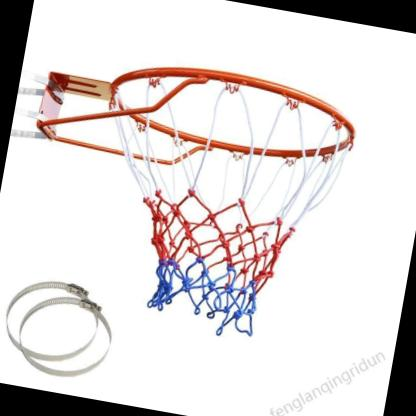

In [32]:
import random
from PIL import Image

# Set seed
random.seed(42) # <- try changing this and see what happens

# 1. Get all image paths (* means "any combination")
image_path_list = list(image_path.glob("*/*/*.jpg"))

# 2. Get random image path
random_image_path = random.choice(image_path_list)

# 3. Get image class from path name (the image class is the name of the directory where the image is stored)<<how it was in image classification, I've upgraded to object detection
#    def get_class_names(self):
#        return {0: "Basketball", 4: "Person", 1: "Hoop", 2:"Hoop", 3: "Basketball"}
image_class = random_image_path.parent.stem

# 4. Open image
img = Image.open(random_image_path)

# 5. Print metadata
print(f"Random image path: {random_image_path}")
print(f"Image class: {image_class}")
print(f"Image height: {img.height}")
print(f"Image width: {img.width}")
img

In [33]:
#are all images the same size?
from PIL import Image
from pathlib import Path

# Define the path to your images directory
test_images_dir = Path('Basketball-2/test/images')

# 1. Get all image paths
# Assuming all images are directly under the specified directory
image_path_list = list(test_images_dir.glob("*.jpg"))

# Initialize variables to store the size of the first image
first_image_size = None
all_same_size = True

# Iterate through each image and check size
for path in image_path_list:
    with Image.open(path) as img:
        if first_image_size is None:
            first_image_size = img.size  # Store the size of the first image
        elif img.size != first_image_size:
            all_same_size = False
            break  # No need to check further

# Print result
if all_same_size:
    print(f"All images are of the same size: {first_image_size}")
else:
    print("Not all images are of the same size.")


All images are of the same size: (416, 416)


YOLO format is [class, x_center, y_center, width, height], and RCNN format is [xmin, ymin, xmax, ymax]

In [34]:
!mkdir going_modular

A subdirectory or file going_modular already exists.


In [56]:
#%%writefile going_modular/utils.py
import os
import torch
from PIL import Image
from torch.utils.data import Dataset
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torchvision import transforms
from torchvision.transforms import ToPILImage
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torchvision.transforms import ToPILImage
import torchvision.transforms as T
from torchvision.transforms import Resize, CenterCrop, ToTensor, Compose
from PIL import ImageOps

class CustomDataset(Dataset):
    def __init__(self, img_dir, label_dir, transform=None, class_names_mapping=None):
        self.img_dir = img_dir
        self.label_dir = label_dir
        self.transform = transform
        self.class_map = class_names_mapping if class_names_mapping is not None else {}

        # Filter out images without bounding boxes
        self.img_names = [img_name for img_name in os.listdir(img_dir) if self.has_boxes(label_dir, img_name)]

        # Gather unique classes
        self.classes = self.get_unique_labels()

    def has_boxes(self, label_dir, img_name):
        label_path = os.path.join(label_dir, img_name.replace('.jpg', '.txt'))
        try:
            with open(label_path, 'r') as file:
                lines = file.readlines()
                return any(len(line.split()) == 5 for line in lines)  # Check if any line has 5 elements
        except FileNotFoundError:
            return False  # If label file is not found, consider it as no boxes

    def __len__(self):
        return len(self.img_names)
    
    def convert_yolo_to_rcnn(self, annotations, img_width, img_height):
        rcnn_boxes = []
        for class_label, bbox in annotations:
            x_center, y_center, width, height = bbox
            xmin = max((x_center - width / 2) * img_width, 0)
            ymin = max((y_center - height / 2) * img_height, 0)
            xmax = min((x_center + width / 2) * img_width, img_width)
            ymax = min((y_center + height / 2) * img_height, img_height)
            rcnn_boxes.append([xmin, ymin, xmax, ymax])
        return rcnn_boxes


    def scale_boxes(self, boxes, original_width, original_height, transformed_width, transformed_height):
        scaled_boxes = []
        for xmin, ymin, xmax, ymax in boxes:
            scaled_xmin = xmin / original_width * transformed_width
            scaled_ymin = ymin / original_height * transformed_height
            scaled_xmax = xmax / original_width * transformed_width
            scaled_ymax = ymax / original_height * transformed_height
            scaled_boxes.append([scaled_xmin, scaled_ymin, scaled_xmax, scaled_ymax])
        return scaled_boxes

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_names[idx])
        label_path = os.path.join(self.label_dir, self.img_names[idx].replace('.jpg', '.txt'))

        # Load image using OpenCV and convert to RGB
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        original_height, original_width = image.shape[:2]
        #print(f"Original image size: {original_width} x {original_height}")  # Debug print

        # Load labels
        annotations = self.load_labels(label_path)

        # Convert YOLO annotations to [xmin, ymin, xmax, ymax] format
        boxes = self.convert_yolo_to_rcnn(annotations, original_width, original_height)

        labels = [annotation[0] for annotation in annotations]

        if self.transform:
            image_pil = Image.fromarray(image)
            transformed_image = self.transform(image_pil)
            transformed_height, transformed_width = transformed_image.size(1), transformed_image.size(2)
            #print(f"Transformed image size: {transformed_width} x {transformed_height}")  # Debug print

            # Scale bounding boxes
            scaled_boxes = self.scale_boxes(boxes, original_width, original_height, transformed_width, transformed_height)

            image = transformed_image
            boxes = scaled_boxes
        else:
            image = T.ToTensor()(image)

        # Convert boxes and labels to tensors
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        target = {'boxes': boxes, 'labels': labels}
        
        image_tensor_size = image.shape
        #print(f"Image tensor size in __getitem__: {image_tensor_size}")  # Debug print

        return image, target

    def visualize_transformation(self, idx):
        # Get the original image and its annotations
        img_path = os.path.join(self.img_dir, self.img_names[idx])
        label_path = os.path.join(self.label_dir, self.img_names[idx].replace('.jpg', '.txt'))

        # Load and display original image
        original_image = cv2.imread(img_path)
        original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
        original_annotations = self.load_labels(label_path)
        original_height, original_width = original_image.shape[:2]

        # Convert YOLO annotations to [xmin, ymin, xmax, ymax] format for the original image
        converted_original_boxes = self.convert_yolo_to_rcnn(original_annotations, original_width, original_height)

        print("Original Image:")
        print("Original Annotations:", original_annotations)
        self.draw_bounding_boxes(original_image, [(ann[0], box) for ann, box in zip(original_annotations, converted_original_boxes)])

        # Apply transformations
        if self.transform:
            image_pil = Image.fromarray(original_image)
            transformed_image = self.transform(image_pil)
            transformed_height, transformed_width = transformed_image.size(1), transformed_image.size(2)

            # Convert YOLO annotations to [xmin, ymin, xmax, ymax] format
            boxes = self.convert_yolo_to_rcnn(original_annotations, original_width, original_height)

            # Scale bounding boxes
            scaled_boxes = self.scale_boxes(boxes, original_width, original_height, transformed_width, transformed_height)
            transformed_annotations = [(label, box) for label, box in zip([ann[0] for ann in original_annotations], scaled_boxes)]

            print("Transformed Image:")
            print("Transformed Annotations:", transformed_annotations)
            self.draw_bounding_boxes(transformed_image, transformed_annotations)
        else:
            transformed_image = original_image
            transformed_annotations = original_annotations

            print("No Transformation Applied:")
            print("Annotations:", transformed_annotations)
            self.draw_bounding_boxes(transformed_image, transformed_annotations)

    def load_labels(self, label_path):
        with open(label_path, 'r') as file:
            lines = file.readlines()

        #print(f"Label file {label_path}:")
        annotations = []
        for line in lines:
            elements = line.split()
            class_label = int(elements[0])
            bbox = list(map(float, elements[1:]))

            # Check if bbox has 4 elements (x_center, y_center, width, height)
            if len(bbox) != 4:
                #print(f"Warning: Incorrect bounding box format in {label_path} for line: {line.strip()}")
                continue  # Skip this line and move to the next one

            # Check if width and height are positive
            if bbox[2] <= 0 or bbox[3] <= 0:
                #print(f"Warning: Non-positive bbox dimensions in {label_path} for line: {line.strip()}")
                continue  # Skip this line and move to the next one

            annotations.append((class_label, bbox))

        #print(f"Parsed annotations for {label_path}: {annotations}")
        return annotations

    #(class_id x_center y_center width height) format
    def draw_bounding_boxes(self, image, annotations):
        # Convert image to numpy array if necessary
        if torch.is_tensor(image):
            image = image.permute(1, 2, 0).numpy()
        elif isinstance(image, Image.Image):
            image = np.array(image)

        img_height, img_width, _ = image.shape
        fig, ax = plt.subplots(1, figsize=(12, 12))
        ax.imshow(image)

        for annotation in annotations:
            class_label, bbox = annotation
            if len(bbox) != 4:
                raise ValueError(f"Expected bbox to have 4 values, got {len(bbox)}: {bbox}")

            xmin, ymin, xmax, ymax = bbox
            box_width = xmax - xmin
            box_height = ymax - ymin

            # Debug print statements
            print(f"Drawing box for class {class_label}: xmin={xmin}, ymin={ymin}, xmax={xmax}, ymax={ymax}")
            print(f"Box dimensions: width={box_width}, height={box_height}")

            class_name = self.class_map.get(class_label, str(class_label))
            rect = patches.Rectangle((xmin, ymin), box_width, box_height, linewidth=2, edgecolor='r', facecolor='none')
            ax.add_patch(rect)
            plt.text(xmin, ymin, class_name, color='white', fontsize=12, weight='bold', bbox=dict(facecolor='red', alpha=0.5, pad=0, edgecolor='none'))

        plt.axis('off')
        plt.show()

    def draw_batch_boxes(self, images, annotations_batch):
        """
        Draw bounding boxes on a batch of images.
        
        Args:
        images (list of PIL Images or tensors): The images in a batch.
        annotations_batch (list of dicts): Each dict contains 'boxes' and 'labels' for an image.
        """
        batch_size = len(images)
        fig, axs = plt.subplots(1, batch_size, figsize=(12 * batch_size, 12))

        if batch_size == 1:  # If there's only one image, axs is not a list
            axs = [axs]

        for i, (image, annotations) in enumerate(zip(images, annotations_batch)):
            if torch.is_tensor(image):
                image = denormalize(image).permute(1, 2, 0).numpy()
            axs[i].imshow(image)
            axs[i].axis('off')

            boxes = annotations['boxes']
            labels = annotations['labels']

            for box, label in zip(boxes, labels):
                xmin, ymin, xmax, ymax = box
                rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none')
                axs[i].add_patch(rect)
                class_name = self.class_map.get(label.item(), str(label.item()))
                axs[i].text(xmin, ymin, class_name, color='white', fontsize=12, weight='bold', bbox=dict(facecolor='red', alpha=0.5, pad=0, edgecolor='none'))

        plt.show()
        
    def get_unique_labels(self):
        """
        Gathers a list of unique class labels from the label files.
        """
        unique_labels = set()
        for img_name in self.img_names:
            label_path = os.path.join(self.label_dir, img_name.replace('.jpg', '.txt'))
            with open(label_path, 'r') as file:
                lines = file.readlines()
                for line in lines:
                    class_label = int(line.split()[0])
                    unique_labels.add(class_label)
        return sorted(unique_labels)
    
    def get_images_for_each_class(self):
        """
        Returns one image for each unique class label in the dataset.
        """
        images_for_classes = {}
        for img_name in self.img_names:
            label_path = os.path.join(self.label_dir, img_name.replace('.jpg', '.txt'))
            annotations = self.load_labels(label_path)
            
            for annotation in annotations:
                class_label = annotation[0]

                if class_label not in images_for_classes:
                    img_path = os.path.join(self.img_dir, img_name)
                    image = Image.open(img_path).convert('RGB')
                    images_for_classes[class_label] = (image, annotations)
                    break

        return images_for_classes
    
    def transform_and_scale_single_image(self, img_input, label_path=None, debug=False):
        if isinstance(img_input, str):
            # If img_input is a file path, read the image from the file
            image = cv2.imread(img_input)
            if image is None:
                raise FileNotFoundError(f"Image file not found: {img_input}")
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        elif isinstance(img_input, np.ndarray):
            # If img_input is an image array (frame), use it directly
            image = img_input
        else:
            raise TypeError("img_input must be a file path or an image array")

        original_height, original_width = image.shape[:2]

        # Load labels if label path is provided
        annotations = self.load_labels(label_path) if label_path else []

        # Convert YOLO annotations to [xmin, ymin, xmax, ymax] format
        boxes = self.convert_yolo_to_rcnn(annotations, original_width, original_height) if label_path else []

        if self.transform:
            image_pil = Image.fromarray(image)
            transformed_image = self.transform(image_pil)
            transformed_height, transformed_width = transformed_image.size(1), transformed_image.size(2)

            # Scale bounding boxes
            scaled_boxes = self.scale_boxes(boxes, original_width, original_height, transformed_width, transformed_height)

            image = transformed_image
            boxes = scaled_boxes
        else:
            image = T.ToTensor()(image)

        if debug:
            print(f"Transformed image size: {transformed_width} x {transformed_height}")
            print(f"Scaled boxes: {scaled_boxes}")

        return image, boxes

    def transform_and_scale_frame(self, frame, debug=False):
        # Directly use the frame (a NumPy array)
        image = frame

        original_height, original_width = image.shape[:2]

        # Assuming no labels are provided for video frames
        annotations = []

        if self.transform:
            image_pil = Image.fromarray(image)
            transformed_image = self.transform(image_pil)
            transformed_height, transformed_width = transformed_image.size(1), transformed_image.size(2)

            # Scale bounding boxes (if any) - here we assume no boxes for video frames
            scaled_boxes = []

            image = transformed_image
        else:
            image = T.ToTensor()(image)

        if debug:
            print(f"Transformed image size: {transformed_width} x {transformed_height}")

        return image




Overwriting going_modular/utils.py


In [ ]:
# Example use
img_dir = train_images_dir
label_dir = train_labels_dir
#for warriors vs cavs 10
class_names_mapping = {0: "Basketball", 1: "Hoop", 
                        2: "Basketball", 3: "Person", 4: "Person"}
#- ball - made - person  - rim - shoot for basketball-2
class_names_mapping = {0: "ball", 1: "made", 2: "person", 
                    3: "rim", 4: "shoot"}

import yaml
import os

def get_class_dict_from_yaml(file_path):
    # Check if the file exists
    if not os.path.exists(file_path):
        raise FileNotFoundError(f"The file {file_path} does not exist.")

    # Read the YAML file
    with open(file_path, 'r') as file:
        data = yaml.safe_load(file)

    # Extract class names and create a dictionary
    class_names = data.get('names', [])
    class_dict = {name: idx for idx, name in enumerate(class_names)}

    return class_dict

file_path = 'Basketball-2/data.yaml'
#class_names_mapping = get_class_dict_from_yaml(file_path)
print(class_names_mapping)

from torchvision import transforms as T

transform = T.Compose([
    T.Resize((800, 800)),  # Resize images to a common size
    T.ToTensor(),  # Convert images to tensor
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize for pre-trained models
])


dataset = CustomDataset(img_dir=train_images_dir, 
                        label_dir=train_labels_dir, 
                        transform=transform, 
                        class_names_mapping=class_names_mapping)

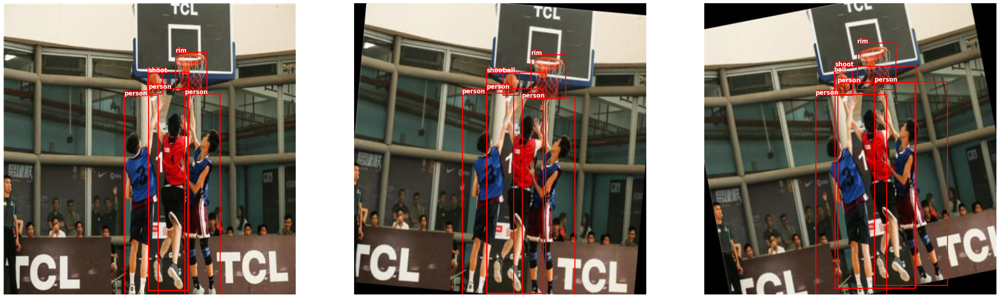

Creating DataLoader's with batch size 32 and 0 workers.


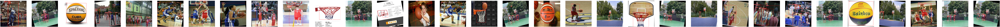

In [36]:
#import Dataloader
from torch.utils.data import DataLoader
#Image post dataloader check****
# Choose a subset of data to visualize
num_samples = 3
subset_data = [dataset[i] for i in range(num_samples)]

# Extract images and annotations
images, annotations_batch = zip(*subset_data)


def denormalize(tensor):
    mean = [0.485, 0.456, 0.406]
    std = [0.229, 0.224, 0.225]
    tensor = tensor.clone()
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)
    return tensor

# Draw bounding boxes
dataset.draw_batch_boxes(images, annotations_batch)



def collate_fn(batch):
    images, targets = zip(*batch)

    # Convert images to a batch tensor
    images = torch.stack(images)

    # Prepare targets (labels and boxes)
    boxes = [target['boxes'] for target in targets]
    labels = [target['labels'] for target in targets]

    targets = [{'boxes': b, 'labels': l} for b, l in zip(boxes, labels)]
    return images, targets


batch_size = 32
num_workers = 0#os.cpu_count()
print(f"Creating DataLoader's with batch size {batch_size} and {num_workers} workers.")
#collate_fn = lambda x: tuple(zip(*x))  # So that DataLoader does not throw an error
dataset_dataloader = DataLoader(dataset=dataset, 
                              batch_size=batch_size, 
                              shuffle=True, 
                              collate_fn=collate_fn, 
                              num_workers=num_workers,
                              pin_memory=True)  # Enable pin_memory for faster transfer to CUDA


# Get one batch from DataLoader
for imgs_tensor, annos in dataset_dataloader:
    dataset.draw_batch_boxes(imgs_tensor, annos)
    break




In [37]:
def test_bbox_conversion():
    sample_annotations = [(0, [0.5, 0.5, 0.2, 0.2])]  # Example YOLO format annotation
    img_width, img_height = 100, 100  # Example image dimensions
    expected_output = [[40, 40, 60, 60]]  # Expected RCNN format bounding box

    converted_boxes = dataset.convert_yolo_to_rcnn(sample_annotations, img_width, img_height)
    print(f"Converted Boxes: {converted_boxes}, Expected: {expected_output}")
    assert converted_boxes == expected_output, f"Conversion error: {converted_boxes} != {expected_output}"

test_bbox_conversion()


Converted Boxes: [[40.0, 40.0, 60.0, 60.0]], Expected: [[40, 40, 60, 60]]


In [38]:
def test_transformations():
    image, target = dataset[0]
    original_boxes = target['boxes'].numpy()
    print(f"Original Boxes: {original_boxes}")

    # Convert the PyTorch tensor to a uint8 NumPy array with the correct dimensions
    image_np = (image.numpy().transpose(1, 2, 0) * 255).astype(np.uint8)

    test_transform = T.Compose([T.Resize((50, 50)), T.ToTensor()])
    transformed_image = test_transform(Image.fromarray(image_np))
    print(f"Transformed Image Size: {transformed_image.size()}")

    scale_x, scale_y = 50 / image.shape[1], 50 / image.shape[2]
    expected_transformed_boxes = [[box[0] * scale_x, box[1] * scale_y, box[2] * scale_x, box[3] * scale_y] for box in original_boxes]
    print(f"Expected Transformed Boxes: {expected_transformed_boxes}")

    scaled_boxes = [[box[0] * scale_x, box[1] * scale_y, box[2] * scale_x, box[3] * scale_y] for box in original_boxes]
    print(f"Scaled Boxes: {scaled_boxes}")

    assert scaled_boxes == expected_transformed_boxes, "Transformation error in bounding boxes"

test_transformations()


Original Boxes: [[470.67307 133.65384 556.25    247.11539]
 [394.71155 188.46153 434.1346  248.07692]
 [330.76923 251.92308 423.07693 800.     ]
 [396.6346  233.17308 503.3654  787.9808 ]
 [496.15384 248.07692 592.3077  800.     ]
 [396.15384 188.46153 505.76923 788.46155]]
Transformed Image Size: torch.Size([3, 50, 50])
Expected Transformed Boxes: [[29.41706657409668, 8.353364944458008, 34.765625, 15.444711685180664], [24.669471740722656, 11.77884578704834, 27.133413314819336, 15.504807472229004], [20.673076629638672, 15.745192527770996, 26.44230842590332, 50.0], [24.789663314819336, 14.573317527770996, 31.460336685180664, 49.24879837036133], [31.009614944458008, 15.504807472229004, 37.019229888916016, 50.0], [24.759614944458008, 11.77884578704834, 31.610576629638672, 49.278846740722656]]
Scaled Boxes: [[29.41706657409668, 8.353364944458008, 34.765625, 15.444711685180664], [24.669471740722656, 11.77884578704834, 27.133413314819336, 15.504807472229004], [20.673076629638672, 15.74519252

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Drawing Original Image with Bounding Boxes
Drawing box for class 3: xmin=470.6730651855469, ymin=133.65383911132812, xmax=556.25, ymax=247.11538696289062
Box dimensions: width=85.57693481445312, height=113.4615478515625
Drawing box for class 0: xmin=394.7115478515625, ymin=188.46153259277344, xmax=434.1346130371094, ymax=248.07691955566406
Box dimensions: width=39.423065185546875, height=59.615386962890625
Drawing box for class 2: xmin=330.76922607421875, ymin=251.92308044433594, xmax=423.0769348144531, ymax=800.0
Box dimensions: width=92.30770874023438, height=548.0769195556641
Drawing box for class 2: xmin=396.6346130371094, ymin=233.17308044433594, xmax=503.3653869628906, ymax=787.9807739257812
Box dimensions: width=106.73077392578125, height=554.8076934814453
Drawing box for class 2: xmin=496.1538391113281, ymin=248.07691955566406, xmax=592.3076782226562, ymax=800.0
Box dimensions: width=96.15383911132812, height=551.9230804443359
Drawing box for class 4: xmin=396.1538391113281, ym

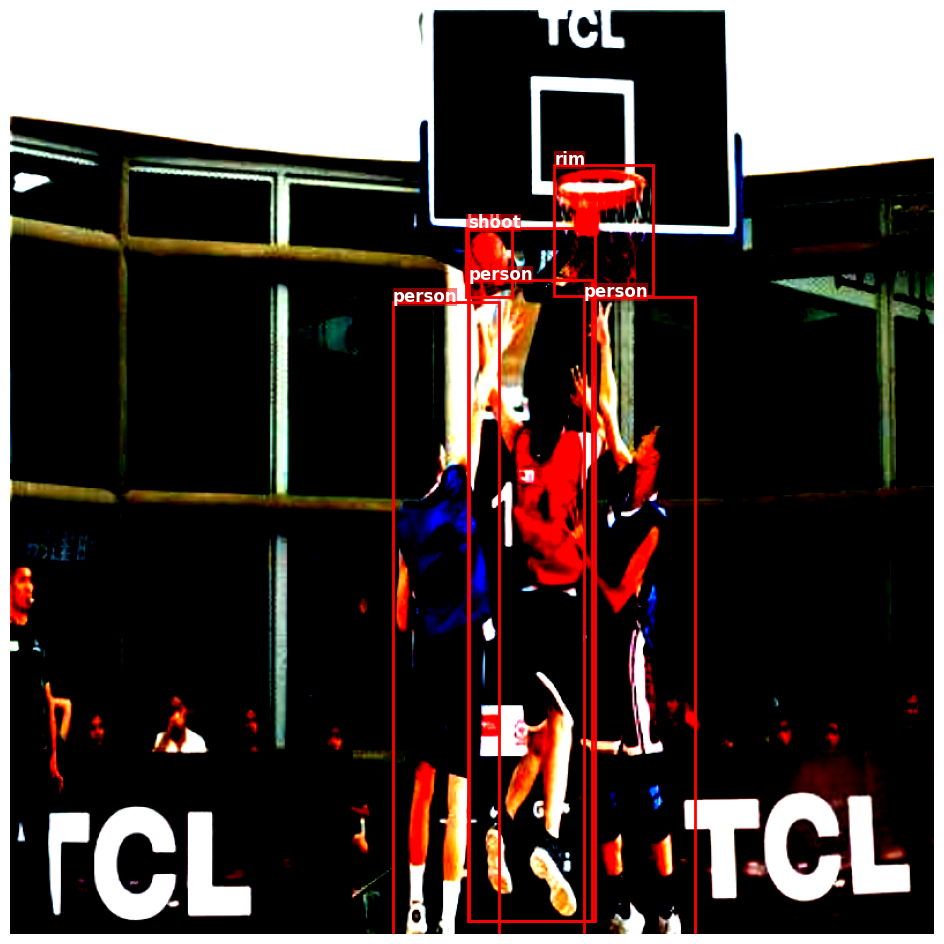

Drawing Transformed Image with Scaled Bounding Boxes
Drawing box for class 3: xmin=29.41706657409668, ymin=8.353364944458008, xmax=34.765625, ymax=15.444711685180664
Box dimensions: width=5.34855842590332, height=7.091346740722656
Drawing box for class 0: xmin=24.669471740722656, ymin=11.77884578704834, xmax=27.133413314819336, ymax=15.504807472229004
Box dimensions: width=2.4639415740966797, height=3.725961685180664
Drawing box for class 2: xmin=20.673076629638672, ymin=15.745192527770996, xmax=26.44230842590332, ymax=50.0
Box dimensions: width=5.769231796264648, height=34.254807472229004
Drawing box for class 2: xmin=24.789663314819336, ymin=14.573317527770996, xmax=31.460336685180664, ymax=49.24879837036133
Box dimensions: width=6.670673370361328, height=34.67548084259033
Drawing box for class 2: xmin=31.009614944458008, ymin=15.504807472229004, xmax=37.019229888916016, ymax=50.0
Box dimensions: width=6.009614944458008, height=34.495192527770996
Drawing box for class 4: xmin=24.7596

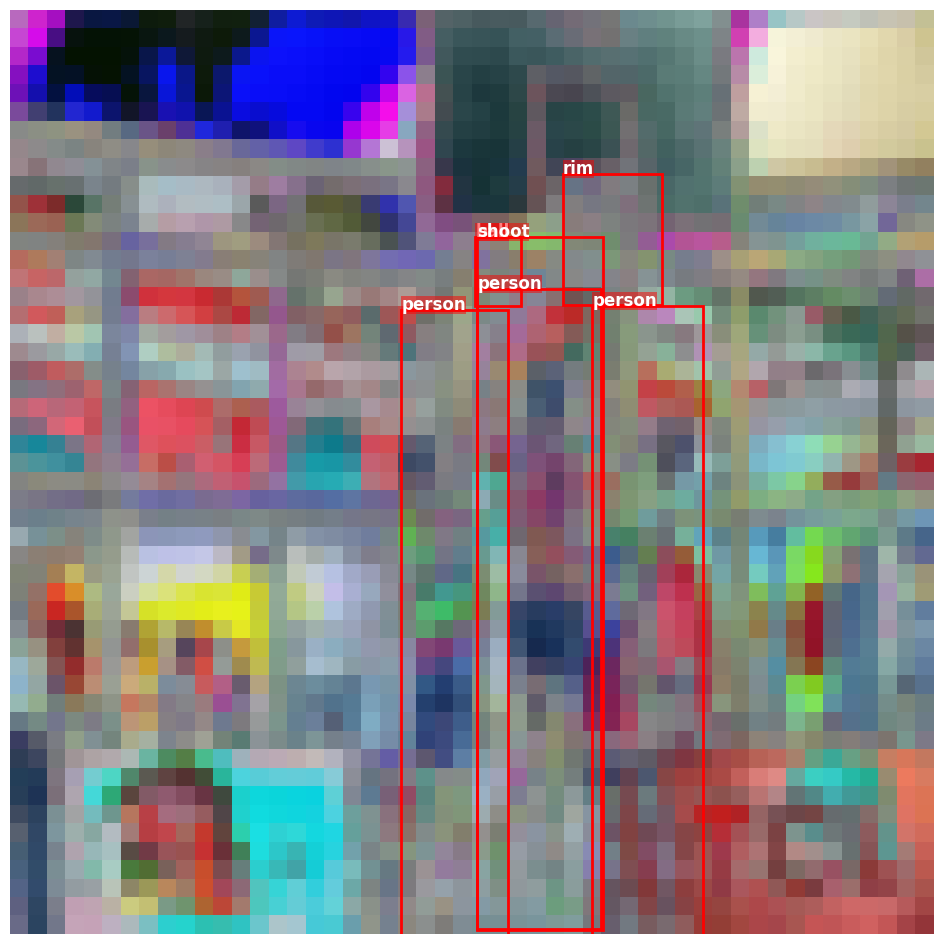

In [39]:
def test_drawing():
    image, target = dataset[0]
    print("Drawing Original Image with Bounding Boxes")
    original_annotations = [(label.item(), box.tolist()) for label, box in zip(target['labels'], target['boxes'])]
    dataset.draw_bounding_boxes(image, original_annotations)

    print("Drawing Transformed Image with Scaled Bounding Boxes")
    # Convert the tensor to a numpy array
    image_np = image.permute(1, 2, 0).numpy()
    # Ensure the image is in the correct data type and range
    if image_np.dtype == np.float32 or image_np.dtype == np.float64:
        # Scale and convert to uint8
        image_np = (image_np * 255).astype(np.uint8)
    
    transformed_image = T.Resize((50, 50))(Image.fromarray(image_np))
    # Ensure the scaling factors are calculated based on the new dimensions
    scale_x, scale_y = 50 / image.shape[2], 50 / image.shape[1]  # width and height scaling
    scaled_boxes = [[bbox[0] * scale_x, bbox[1] * scale_y, bbox[2] * scale_x, bbox[3] * scale_y] for _, bbox in original_annotations]

    transformed_annotations = [(label.item(), box) for label, box in zip(target['labels'], scaled_boxes)]
    dataset.draw_bounding_boxes(transformed_image, transformed_annotations)

test_drawing()


Original Image:
Original Annotations: [(3, [0.6646634615384616, 0.2512019230769231, 0.11778846153846154, 0.15144230769230768]), (0, [0.5372596153846154, 0.27524038461538464, 0.055288461538461536, 0.07932692307692307]), (2, [0.4579326923076923, 0.6538461538461539, 0.17548076923076922, 0.6923076923076923]), (2, [0.5504807692307693, 0.6430288461538461, 0.19230769230769232, 0.7019230769230769]), (2, [0.6646634615384616, 0.6610576923076923, 0.18028846153846154, 0.6778846153846154]), (4, [0.5540865384615384, 0.6153846153846154, 0.20192307692307693, 0.7596153846153846])]
Drawing box for class 3: xmin=252.00000000000003, ymin=73.0, xmax=301.0, ymax=136.0
Box dimensions: width=48.99999999999997, height=63.0
Drawing box for class 0: xmin=212.00000000000003, ymin=98.00000000000001, xmax=235.0, ymax=131.0
Box dimensions: width=22.99999999999997, height=32.999999999999986
Drawing box for class 2: xmin=154.0, ymin=128.0, xmax=226.99999999999997, ymax=416.0
Box dimensions: width=72.99999999999997, he

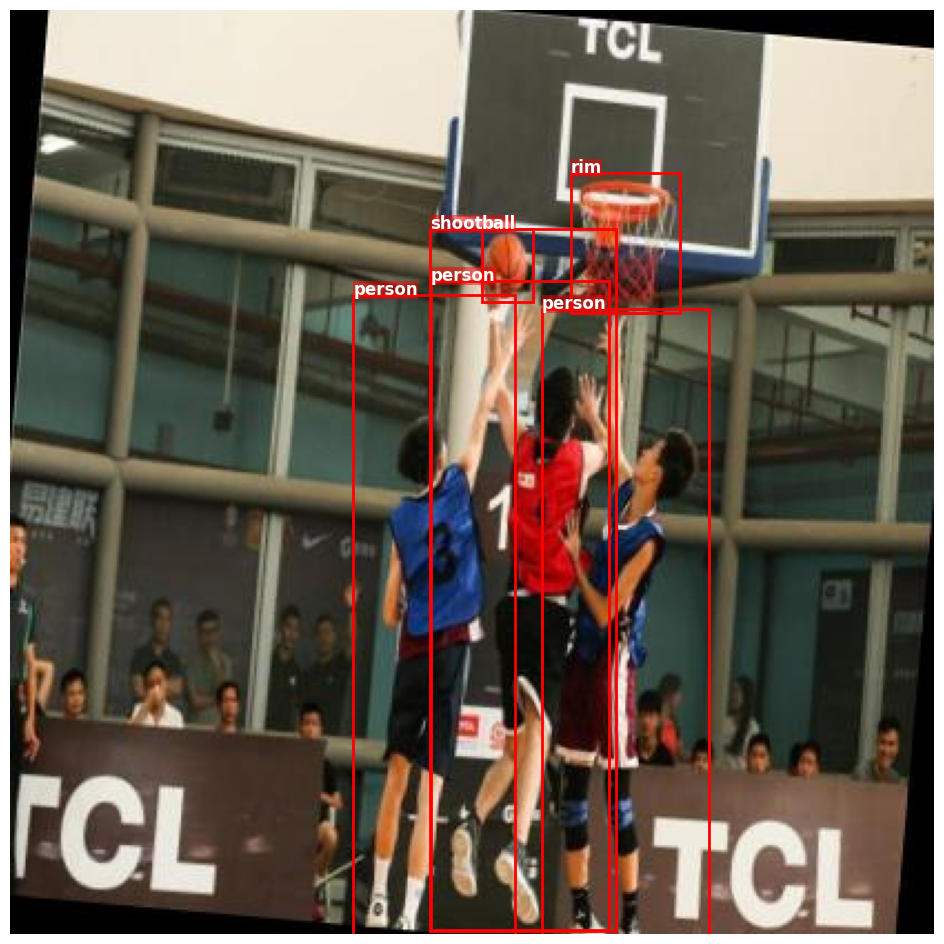

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Transformed Image:
Transformed Annotations: [(3, [484.61538461538464, 140.3846153846154, 578.8461538461538, 261.53846153846155]), (0, [407.69230769230774, 188.46153846153848, 451.9230769230769, 251.9230769230769]), (2, [296.1538461538462, 246.15384615384616, 436.5384615384615, 800.0]), (2, [363.4615384615385, 233.65384615384616, 517.3076923076924, 795.1923076923076]), (2, [459.61538461538464, 257.69230769230774, 603.8461538461538, 800.0]), (4, [362.5, 188.46153846153854, 524.0384615384615, 796.1538461538462])]
Drawing box for class 3: xmin=484.61538461538464, ymin=140.3846153846154, xmax=578.8461538461538, ymax=261.53846153846155
Box dimensions: width=94.23076923076917, height=121.15384615384616
Drawing box for class 0: xmin=407.69230769230774, ymin=188.46153846153848, xmax=451.9230769230769, ymax=251.9230769230769
Box dimensions: width=44.23076923076917, height=63.461538461538424
Drawing box for class 2: xmin=296.1538461538462, ymin=246.15384615384616, xmax=436.5384615384615, ymax=800

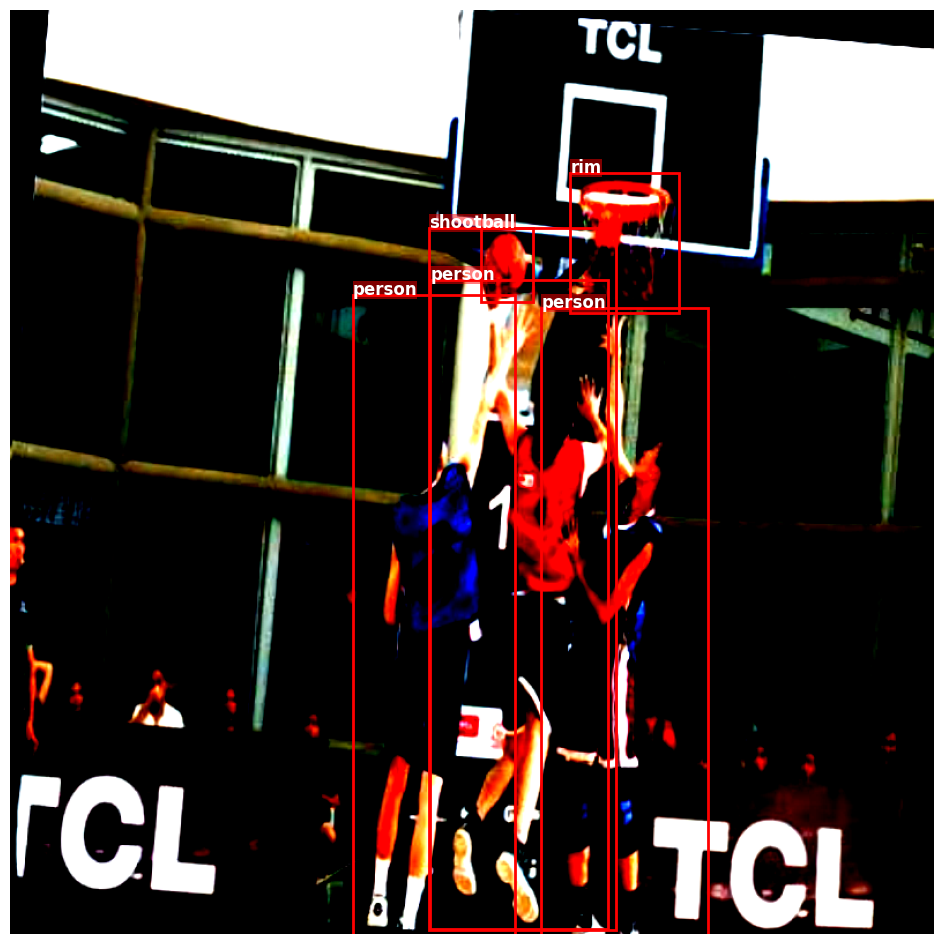

In [40]:
image_index = 1  # Change this to the index of the image you want to check
dataset.visualize_transformation(image_index)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image size: torch.Size([3, 800, 800])
Bounding boxes: tensor([[295.6731, 103.3654, 473.5577, 756.2500],
        [527.8846,  85.5769, 610.5769, 208.6538],
        [428.8462, 105.2885, 473.0769, 169.7115],
        [296.6346, 144.7115, 474.5192, 755.2885],
        [252.8846, 423.5577, 331.7308, 799.5192],
        [154.8077, 323.5577, 245.1923, 799.5192],
        [ 33.1731, 429.3269, 172.5962, 799.5192]])
Class labels: tensor([4, 3, 0, 2, 2, 2, 2])
Drawing box for class 4: xmin=295.6730651855469, ymin=103.36538696289062, xmax=473.55767822265625, ymax=756.25
Box dimensions: width=177.88461303710938, height=652.8846130371094
Drawing box for class 3: xmin=527.8846435546875, ymin=85.57691955566406, xmax=610.576904296875, ymax=208.65383911132812
Box dimensions: width=82.6922607421875, height=123.07691955566406
Drawing box for class 0: xmin=428.8461608886719, ymin=105.28845977783203, xmax=473.0769348144531, ymax=169.71153259277344
Box dimensions: width=44.23077392578125, height=64.4230728149414


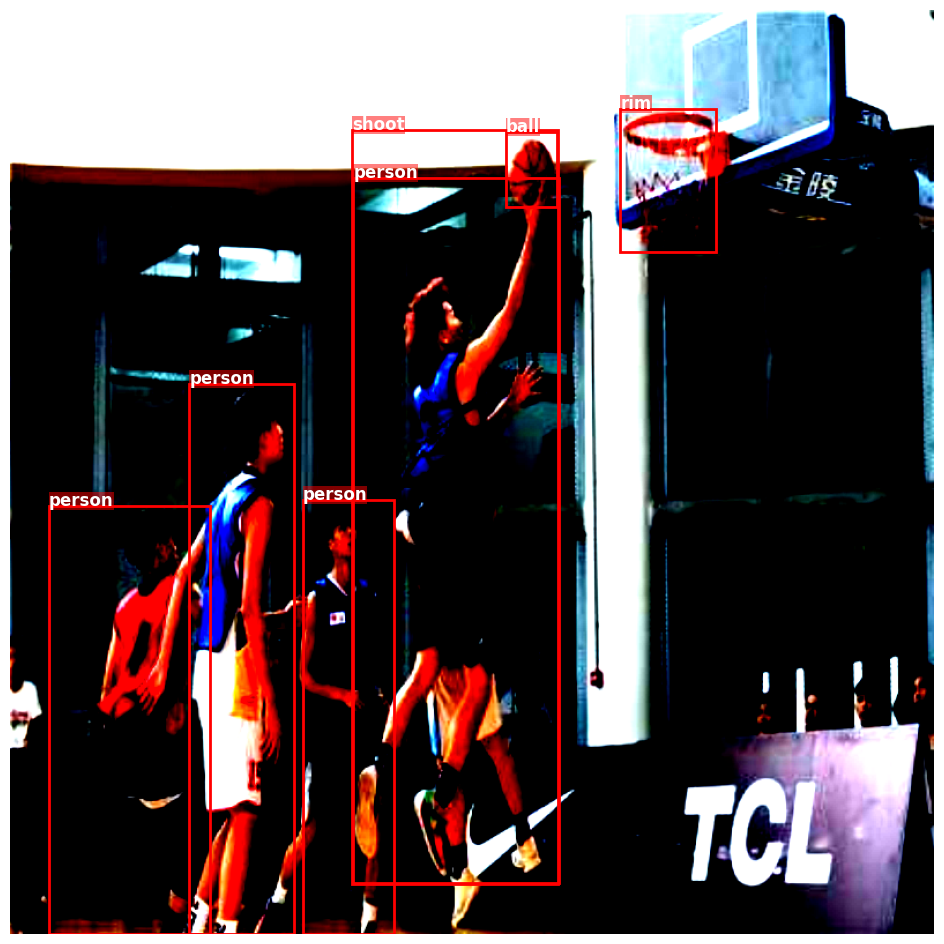

In [41]:


#class_names_mapping = {0: "Basketball", 1: "Hoop", 2: "Hoop", 3: "Basketball", 4: "Person"}

transform = T.Compose([
    T.Resize((800, 800)),  # Resize images to a common size
    T.ToTensor(),  # Convert images to tensor
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize for pre-trained models
])


# Split the customdataset into train/test sets
train_data = CustomDataset(img_dir=test_images_dir, 
                           label_dir=test_labels_dir, 
                           transform=transform,
                           class_names_mapping=class_names_mapping)


test_data = CustomDataset(img_dir=train_images_dir, 
                           label_dir=train_labels_dir, 
                            transform=transform,
                           class_names_mapping=class_names_mapping,)

image, target = train_data[0]
print(f"Image size: {image.size()}")
print(f"Bounding boxes: {target['boxes']}")
print(f"Class labels: {target['labels']}")

# Draw bounding boxes on the image
annotations = [(label.item(), box.tolist()) for label, box in zip(target['labels'], target['boxes'])]
train_data.draw_bounding_boxes(image, annotations)

In [42]:
def collate_fn(batch):
    images, targets = zip(*batch)  # Unzip the batch

    # Convert images to a batch tensor
    images = torch.stack([img for img in images], dim=0)

    # Prepare targets (labels and boxes)
    boxes = [target['boxes'] for target in targets]
    labels = [target['labels'] for target in targets]

    # Convert boxes and labels to tensors
    boxes = [torch.as_tensor(box, dtype=torch.float32) for box in boxes]
    labels = [torch.as_tensor(label, dtype=torch.int64) for label in labels]

    targets = [{'boxes': b, 'labels': l} for b, l in zip(boxes, labels)]

        # Debug: Print the shapes of boxes in targets
    #for i, t in enumerate(targets):
    #    print(f"Debug: Batch item {i} - Boxes tensor shape in target = {t['boxes'].shape}")

    return images, targets

In [43]:

# 2. Turn data into DataLoaders
import os
from torch.utils.data import DataLoader

# Setup batch size and number of workers 
batch_size = 32
num_workers = 0#os.cpu_count()
print(f"Creating DataLoader's with batch size {batch_size} and {num_workers} workers.")
#collate_fn = lambda x: tuple(zip(*x))  # So that DataLoader does not throw an error
train_dataloader = DataLoader(dataset=train_data, 
                              batch_size=batch_size, 
                              shuffle=True, 
                              collate_fn=collate_fn, 
                              num_workers=num_workers,
                              pin_memory=True)  # Enable pin_memory for faster transfer to CUDA

test_dataloader = DataLoader(dataset=test_data, 
                             batch_size=batch_size, 
                             shuffle=False, 
                             collate_fn=collate_fn, 
                             num_workers=num_workers,
                             pin_memory=True)

# Iterate over DataLoader
for imgs, annos in train_dataloader:
    print(f"Batch size: {len(imgs)}")
    print(f"Image tensor shape: {imgs.shape}")
    print(f"Annotations in the first image of the batch: {annos[0]}")
    break



Creating DataLoader's with batch size 32 and 0 workers.
Batch size: 32
Image tensor shape: torch.Size([32, 3, 800, 800])
Annotations in the first image of the batch: {'boxes': tensor([[320.6731, 429.8077, 365.8654, 612.5000],
        [383.6538, 357.2115, 406.7308, 404.3269],
        [279.8077, 552.8846, 293.2692, 575.9615]]), 'labels': tensor([2, 3, 0])}


Faster R-CNN and other similar object detection models, bounding boxes are expected to be in the format [xmin,ymin,xmax,ymax][xmin,ymin,xmax,ymax], where (xmin,ymin)(xmin,ymin) is the top-left corner and (xmax,ymax)(xmax,ymax) is the bottom-right corner of the bounding bo

In [44]:
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.models.detection as detection
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor



# Function to get the model
def get_faster_rcnn_model(num_classes):
    # Load a pre-trained model for common objects in COCO
    model = fasterrcnn_resnet50_fpn(pretrained=True)

    # Get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features

    # Replace the pre-trained head with a new one (adjust for num_classes)
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    return model

# Instantiate the model
num_classes = len(dataset.classes) + 1  # +1 for background class
model = get_faster_rcnn_model(num_classes).to(device)

# Define the optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Define the learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

# Define the loss function
loss_fn = nn.CrossEntropyLoss()

c:\Users\ghadf\vscode_projects\venv_projects\Pytorch\YOLO\.venv\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\ghadf\vscode_projects\venv_projects\Pytorch\YOLO\.venv\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [45]:
# Install torchinfo if it's not available, import it if it is
import torchinfo

    
from torchinfo import summary
summary(model, input_size=[1, 3, 800, 800]) # do a test pass through of an example input size 

Layer (type:depth-idx)                                  Output Shape              Param #
FasterRCNN                                              [100, 4]                  --
├─GeneralizedRCNNTransform: 1-1                         [1, 3, 800, 800]          --
├─BackboneWithFPN: 1-2                                  [1, 256, 13, 13]          --
│    └─IntermediateLayerGetter: 2-1                     [1, 2048, 25, 25]         --
│    │    └─Conv2d: 3-1                                 [1, 64, 400, 400]         (9,408)
│    │    └─FrozenBatchNorm2d: 3-2                      [1, 64, 400, 400]         --
│    │    └─ReLU: 3-3                                   [1, 64, 400, 400]         --
│    │    └─MaxPool2d: 3-4                              [1, 64, 200, 200]         --
│    │    └─Sequential: 3-5                             [1, 256, 200, 200]        (212,992)
│    │    └─Sequential: 3-6                             [1, 512, 100, 100]        1,212,416
│    │    └─Sequential: 3-7              

In [46]:
from torchvision.ops import box_iou

 #New IoU based metrics calculation function
def calculate_iou_metrics(pred_boxes, true_boxes, iou_threshold=0.5):
    true_positives = 0
    false_positives = 0
    false_negatives = 0

    for pred, true in zip(pred_boxes, true_boxes):
        # Check if either predicted or true boxes are empty
        if pred['boxes'].nelement() == 0 or true['boxes'].nelement() == 0:
            if pred['boxes'].nelement() == 0 and true['boxes'].nelement() != 0:
                false_negatives += len(true['boxes'])
            continue

        iou = box_iou(pred['boxes'], true['boxes'])

        for i in range(len(pred['boxes'])):
            if iou[i].max() > iou_threshold:
                true_positives += 1
            else:
                false_positives += 1

        false_negatives += len(true['boxes']) - iou.max(dim=0)[0].sum().item()

    precision = true_positives / (true_positives + false_positives) if true_positives + false_positives > 0 else 0
    recall = true_positives / (true_positives + false_negatives) if true_positives + false_negatives > 0 else 0
    return precision, recall


In [47]:
def calculate_accuracy(pred_boxes, true_boxes, iou_threshold=0.5):
    accuracy = 0.0
    for pred, true in zip(pred_boxes, true_boxes):
        iou = box_iou(pred['boxes'], true['boxes'])
        correct_predictions = iou > iou_threshold

        # Check for division by zero
        if correct_predictions.numel() == 0:
            continue

        accuracy += correct_predictions.sum().item() / correct_predictions.numel()
    return accuracy / len(pred_boxes) if len(pred_boxes) > 0 else 0.0

In [48]:
from collections import defaultdict

def update_confusion_matrix(matrix, preds, targets, iou_threshold=0.5):
    for pred, true in zip(preds, targets):
        pred_boxes = pred['boxes']
        true_boxes = true['boxes']

        if pred_boxes.nelement() == 0 and true_boxes.nelement() == 0:
            continue  # Skip if both are empty

        if pred_boxes.nelement() == 0:
            matrix['FN'] += len(true_boxes)
            continue

        if true_boxes.nelement() == 0:
            matrix['FP'] += len(pred_boxes)
            continue

        iou = box_iou(pred_boxes, true_boxes)
        for i in range(len(pred_boxes)):
            if iou[i].max() > iou_threshold:
                matrix['TP'] += 1
            else:
                matrix['FP'] += 1

        matrix['FN'] += len(true_boxes) - iou.max(dim=0)[0].sum().item()


In [49]:
from tqdm.auto import tqdm
from torch.utils.tensorboard import SummaryWriter

# Assume necessary imports and initializations here
writer = SummaryWriter()

def train_step(model, optimizer, data_loader, device, epoch, writer):
    model.train()
    running_loss = 0.0
    progress_bar = tqdm(data_loader, desc=f"Epoch {epoch+1}", leave=False)

    for images, targets in progress_bar:
        # Skip batches with no targets
        if not any([len(t["boxes"]) for t in targets]):
            continue

        images = list(img.to(device) for img in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        running_loss += losses.item()
        progress_bar.set_postfix(loss=running_loss/len(data_loader), refresh=True)

    avg_loss = running_loss / len(data_loader)
    writer.add_scalar('Loss/Train', avg_loss, epoch)
    print(f"Epoch: {epoch+1} - Avg Loss: {avg_loss}")
    return avg_loss


def evaluate(model, data_loader, device, epoch, writer):
    model.eval()
    test_accuracy = 0.0
    test_precision = 0.0
    test_recall = 0.0
    confusion_matrix = defaultdict(int)  # Initialize a confusion matrix

    with torch.no_grad():
        for batch_idx, (images, targets) in enumerate(tqdm(data_loader, desc="Evaluating", leave=False)):
            images = list(img.to(device) for img in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            
            preds = model(images)
            update_confusion_matrix(confusion_matrix, preds, targets)
            precision, recall = calculate_iou_metrics(preds, targets)
            test_precision += precision
            test_recall += recall
            test_accuracy += calculate_accuracy(preds, targets)

    test_precision /= len(data_loader)
    test_recall /= len(data_loader)
    test_accuracy /= len(data_loader)
    writer.add_scalar('Metrics/Precision', test_precision, epoch)
    writer.add_scalar('Metrics/Recall', test_recall, epoch)
    writer.add_scalar('Metrics/Accuracy', test_accuracy, epoch)

    # Log confusion matrix
    for key, value in confusion_matrix.items():
        writer.add_scalar(f'ConfusionMatrix/{key}', value, epoch)

    print(f"Epoch: {epoch+1} - Precision: {test_precision}, Recall: {test_recall}, Accuracy: {test_accuracy}")
    return test_precision, test_recall, test_accuracy


def train_and_evaluate(model, train_dataloader, test_dataloader, optimizer, lr_scheduler, device, num_epochs, writer):
    best_accuracy = 0.0 # Add a variable to store the best accuracy
    best_model_path = "best_model.pth"  # Path to save the best model
    
    train_losses = []
    test_precisions = []
    test_recalls = []
    test_accuracies = []  # Add a list to store accuracies

    for epoch in range(num_epochs):
        avg_loss = train_step(model, optimizer, train_dataloader, device, epoch, writer)
        train_losses.append(avg_loss)

        # Unpack three values here
        test_precision, test_recall, test_accuracy = evaluate(model, test_dataloader, device, epoch, writer)
        test_precisions.append(test_precision)
        test_recalls.append(test_recall)
        test_accuracies.append(test_accuracy)  # Store the accuracy

        if test_accuracy > best_accuracy:
            best_accuracy = test_accuracy
            torch.save(model.state_dict(), 'best_model.pth')
            print(f"Model save to {best_model_path}")
            print("Saved best model!")

    print(f"Best Model Accuracy: {best_accuracy}")
    return train_losses, test_precisions, test_recalls, test_accuracies  # Return the accuracies as well



# Training and Evaluation
#num_epochs = 1
#train_and_evaluate(model, train_dataloader, test_dataloader, optimizer, lr_scheduler, device, num_epochs, writer)


In [50]:

# Adjust the call to train_and_evaluate accordingly
num_epochs = 30
train_losses, test_precisions, test_recalls, test_accuracies = train_and_evaluate(model, train_dataloader, test_dataloader, optimizer, lr_scheduler, device, num_epochs, writer)


Epoch: 1 - Avg Loss: 3.960086460296924


Epoch: 1 - Precision: 0.0, Recall: 0.0, Accuracy: 0.0


Epoch: 2 - Avg Loss: 0.7079744889185979


Epoch: 2 - Precision: 0.09929889310186933, Recall: 0.14729093672730573, Accuracy: 0.039987869531979574
Model save to best_model.pth
Saved best model!


Epoch: 3 - Avg Loss: 0.5331769975332113


Epoch: 3 - Precision: 0.10821140497976471, Recall: 0.3603740545280767, Accuracy: 0.05346591869925157
Model save to best_model.pth
Saved best model!


Epoch: 4 - Avg Loss: 0.48418545035215527


Epoch: 4 - Precision: 0.06053747632937982, Recall: 0.5143778847581051, Accuracy: 0.034382192133036636


Epoch: 5 - Avg Loss: 0.4481103832905109


Epoch: 5 - Precision: 0.04469856806015965, Recall: 0.6160292699088842, Accuracy: 0.016468161813280296


Epoch: 6 - Avg Loss: 0.4364758546535785


Epoch: 6 - Precision: 0.047052046811524036, Recall: 0.6088557990956176, Accuracy: 0.016842380888607057


Epoch: 7 - Avg Loss: 0.41858906700060916


Epoch: 7 - Precision: 0.08318516391245134, Recall: 0.5797310645949837, Accuracy: 0.02915622767502707


Epoch: 8 - Avg Loss: 0.41330724496107835


Epoch: 8 - Precision: 0.048046082009035186, Recall: 0.6726947356563518, Accuracy: 0.016379955639419696


Epoch: 9 - Avg Loss: 0.4080858849562131


Epoch: 9 - Precision: 0.07659884792392631, Recall: 0.7134677960446667, Accuracy: 0.025282548404645368


Epoch: 10 - Avg Loss: 0.39456510773071873


Epoch: 10 - Precision: 0.1160649769704517, Recall: 0.642963563413087, Accuracy: 0.041092362036777304


Epoch: 11 - Avg Loss: 0.39932294075305647


Epoch: 11 - Precision: 0.06040519230926455, Recall: 0.6937583763739191, Accuracy: 0.01983453121585318


Epoch: 12 - Avg Loss: 0.3952048627229837


Epoch: 12 - Precision: 0.11848479942705635, Recall: 0.7311767686737266, Accuracy: 0.041857297313609015


Epoch: 13 - Avg Loss: 0.3800784762089069


Epoch: 13 - Precision: 0.07648295592227479, Recall: 0.7685507328545453, Accuracy: 0.027501921809181526


Epoch: 14 - Avg Loss: 0.37392354240784276


Epoch: 14 - Precision: 0.11502859015517439, Recall: 0.7717504769657281, Accuracy: 0.0442138038899873


Epoch: 15 - Avg Loss: 0.3593590305401729


Epoch: 15 - Precision: 0.1289088466954727, Recall: 0.7409770433306575, Accuracy: 0.05472732550626814
Model save to best_model.pth
Saved best model!


Epoch: 16 - Avg Loss: 0.35893181424874526


Epoch: 16 - Precision: 0.13509441267886768, Recall: 0.7814278247361869, Accuracy: 0.05639276522064407
Model save to best_model.pth
Saved best model!


Epoch: 17 - Avg Loss: 0.3557398227544931


Epoch: 17 - Precision: 0.11593522968114812, Recall: 0.7863207371727332, Accuracy: 0.047549899845471505


Epoch: 18 - Avg Loss: 0.34988748798003566


Epoch: 18 - Precision: 0.12083338067587018, Recall: 0.7823114673094992, Accuracy: 0.050801198286585525


Epoch: 19 - Avg Loss: 0.3420261855308826


Epoch: 19 - Precision: 0.1012631612718608, Recall: 0.7790898185450966, Accuracy: 0.04457550279149356


Epoch: 20 - Avg Loss: 0.3413293751386496


Epoch: 20 - Precision: 0.2244003922116603, Recall: 0.7225732819474775, Accuracy: 0.09303740366861978
Model save to best_model.pth
Saved best model!


Epoch: 21 - Avg Loss: 0.3438606422681075


Epoch: 21 - Precision: 0.19629177871442555, Recall: 0.7652962845979028, Accuracy: 0.08047205881988162


Epoch: 22 - Avg Loss: 0.33744258147019607


Epoch: 22 - Precision: 0.15475806909203219, Recall: 0.8091268206590606, Accuracy: 0.064171510898242


Epoch: 23 - Avg Loss: 0.32415032386779785


Epoch: 23 - Precision: 0.14427027572241966, Recall: 0.8109546056561412, Accuracy: 0.0548580805819139


Epoch: 24 - Avg Loss: 0.32927854932271516


Epoch: 24 - Precision: 0.10298365837072188, Recall: 0.7810731729272414, Accuracy: 0.04403366116611688


Epoch: 25 - Avg Loss: 0.3181799077070676


Epoch: 25 - Precision: 0.2157079397713725, Recall: 0.7302715658720911, Accuracy: 0.10527777361807779
Model save to best_model.pth
Saved best model!


Epoch: 26 - Avg Loss: 0.31381958493819606


Epoch: 26 - Precision: 0.15783070758756654, Recall: 0.7773571599718551, Accuracy: 0.06306437631499266


Epoch: 27 - Avg Loss: 0.30427929759025574


Epoch: 27 - Precision: 0.14837650977388916, Recall: 0.8049271881131597, Accuracy: 0.06113568122340087


Epoch: 28 - Avg Loss: 0.30707824459442723


Epoch: 28 - Precision: 0.20577418655202298, Recall: 0.7850584402626065, Accuracy: 0.08849053672644548


Epoch: 29 - Avg Loss: 0.2940055292386275


Epoch: 29 - Precision: 0.2524864766168893, Recall: 0.7615846093241261, Accuracy: 0.11320429536995057
Model save to best_model.pth
Saved best model!


Epoch: 30 - Avg Loss: 0.2928570451644751


Epoch: 30 - Precision: 0.24451459687856172, Recall: 0.7679941930951718, Accuracy: 0.10055120450177817
Best Model Accuracy: 0.11320429536995057


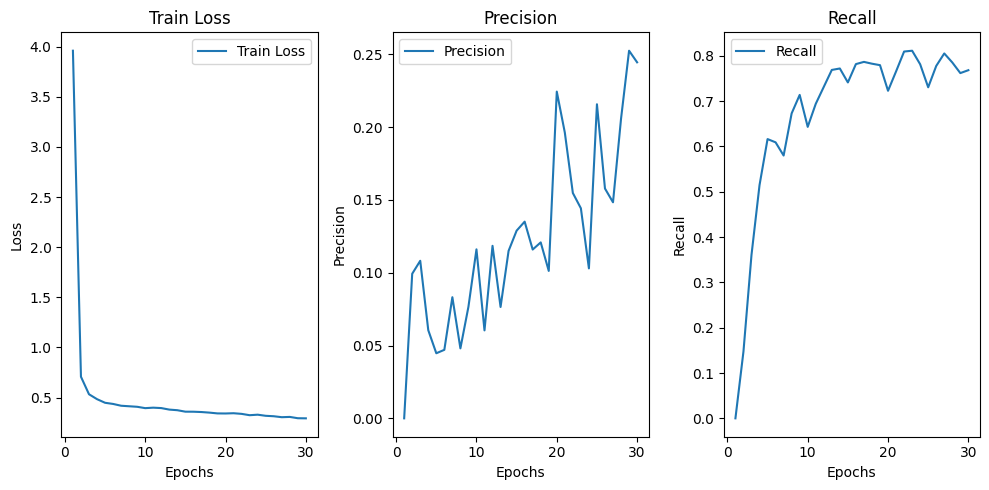

In [51]:
# Plotting results
def plot_results(train_losses, test_precisions, test_recalls):
    epochs = range(1, num_epochs + 1)
    plt.figure(figsize=(10, 5))
    
    plt.subplot(1, 3, 1)
    plt.plot(epochs, train_losses, label='Train Loss')
    plt.title('Train Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 3, 2)
    plt.plot(epochs, test_precisions, label='Precision')
    plt.title('Precision')
    plt.xlabel('Epochs')
    plt.ylabel('Precision')
    plt.legend()

    plt.subplot(1, 3, 3)
    plt.plot(epochs, test_recalls, label='Recall')
    plt.title('Recall')
    plt.xlabel('Epochs')
    plt.ylabel('Recall')
    plt.legend()

    plt.tight_layout()
    plt.show()

plot_results(train_losses, test_precisions, test_recalls)

writer.close()

In [3]:
import torch
from PIL import Image
import cv2
from torchvision import transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import yaml
import os
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torchvision.transforms.functional import to_pil_image
import numpy as np

# Load the saved model
def load_model(model_path, num_classes):
    model = fasterrcnn_resnet50_fpn(pretrained=False)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))
    model.eval()
    return model

# Define transformation that preserves the aspect ratio
def transform_image(image_pil, target_size=800):
    original_width, original_height = image_pil.size
    aspect_ratio = original_width / original_height
    new_height, new_width = target_size, target_size

    if aspect_ratio > 1:  # Width is greater than height
        new_height = int(target_size / aspect_ratio)
    else:  # Height is greater or equal to width
        new_width = int(target_size * aspect_ratio)

    resized_image = T.Resize((new_height, new_width))(image_pil)
    transformed_image = T.ToTensor()(resized_image)
    transformed_image = T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])(transformed_image)
    return transformed_image, new_width, new_height

# Function to scale boxes
def scale_boxes(boxes, original_width, original_height, transformed_width, transformed_height):
    scaled_boxes = []
    for xmin, ymin, xmax, ymax in boxes:
        print(f"Original: {xmin}, {ymin}, {xmax}, {ymax}")
        scaled_xmin = xmin / original_width * transformed_width
        scaled_ymin = ymin / original_height * transformed_height
        scaled_xmax = xmax / original_width * transformed_width
        scaled_ymax = ymax / original_height * transformed_height
        print(f"Scaled: {scaled_xmin}, {scaled_ymin}, {scaled_xmax}, {scaled_ymax}")
        scaled_boxes.append([scaled_xmin, scaled_ymin, scaled_xmax, scaled_ymax])
    return scaled_boxes

def get_class_dict_from_yaml(file_path):
    if not os.path.exists(file_path):
        raise FileNotFoundError(f"The file {file_path} does not exist.")
    with open(file_path, 'r') as file:
        data = yaml.safe_load(file)
    class_names = data.get('names', [])
    return {name: idx for idx, name in enumerate(class_names)}

Original image size (HxW): 416x416
Transformed image size (HxW): 800x800
Original: 376.52545166015625, 340.24273681640625, 397.47967529296875, 387.56884765625
Scaled: 724.087407038762, 654.3129554161658, 764.3839909480168, 745.32470703125
Original: 434.6414489746094, 424.545166015625, 470.0567932128906, 576.4857177734375
Scaled: 835.8489403357872, 816.4330115685096, 903.9553715632511, 1108.6263803335337
Original: 414.1592102050781, 359.3759765625, 463.5494689941406, 581.473388671875
Scaled: 796.4600196251502, 691.1076472355769, 891.4412865271935, 1118.2180551382212
Original: 416.79412841796875, 462.8447570800781, 476.2255859375, 526.7542114257812
Scaled: 801.5271700345553, 890.0860713078426, 915.8184344951924, 1012.9888681265024
Original: 412.4101257324219, 361.8099670410156, 454.0632629394531, 487.6806945800781
Scaled: 793.0963956392728, 695.7883981557993, 873.1985825758715, 937.8474895770732
Original: 372.49420166015625, 344.6253967285156, 397.57012939453125, 369.5525207519531
Scaled

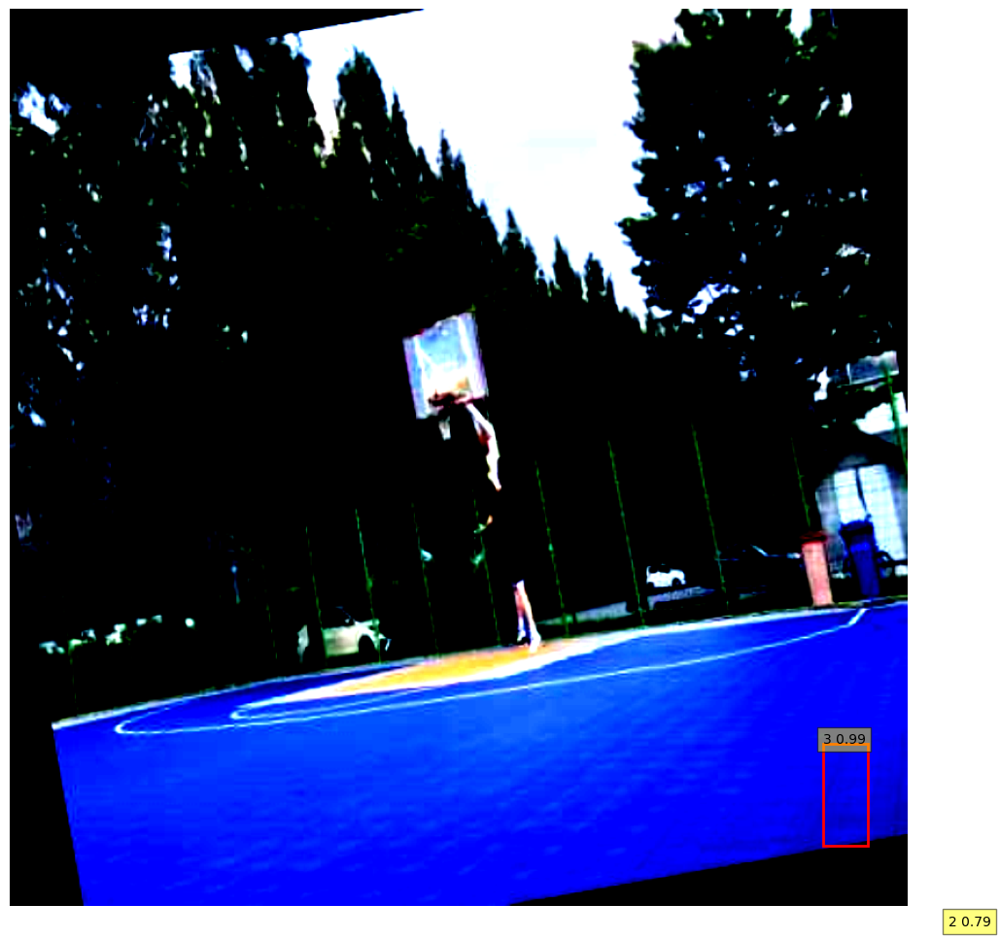

In [32]:

# Function to predict
def predict(image_path, model, device):
    image_bgr = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    image_pil = Image.fromarray(image_rgb)

    transformed_image, transformed_width, transformed_height = transform_image(image_pil)
    transformed_image = transformed_image.unsqueeze(0).to(device)

    original_height, original_width = image_rgb.shape[:2]
    print(f"Original image size (HxW): {original_height}x{original_width}")

    model.eval()
    with torch.no_grad():
        predictions = model(transformed_image)[0]

    print(f"Transformed image size (HxW): {transformed_height}x{transformed_width}")

    scaled_boxes = scale_boxes(predictions['boxes'].cpu().numpy(), original_width, original_height, transformed_width, transformed_height)
    
    for i, box in enumerate(predictions['boxes']):
        original_box = box.cpu().numpy()
        expected_scaled_box = [
            original_box[0] / original_width * transformed_width,
            original_box[1] / original_height * transformed_height,
            original_box[2] / original_width * transformed_width,
            original_box[3] / original_height * transformed_height
        ]

        print(f"Original box: {original_box}, Scaled box: {scaled_boxes[i]}, Expected scaled box: {expected_scaled_box}")
        if not np.allclose(scaled_boxes[i], expected_scaled_box):
            print(f"Discrepancy found in box {i}")

    predictions['boxes'] = torch.tensor(scaled_boxes)
    return transformed_image.squeeze(0), predictions


# Function to draw predictions
def draw_predictions(image_tensor, predictions, threshold=0.5):
    image_tensor = image_tensor.cpu().clamp(0, 1)
    image_pil = to_pil_image(image_tensor)
    plt.figure(figsize=(12,12))
    plt.imshow(image_pil)
    ax = plt.gca()
    boxes = predictions["boxes"].cpu().detach().numpy()
    labels = predictions["labels"].cpu().detach().numpy()
    scores = predictions["scores"].cpu().detach().numpy()
    for box, label, score in zip(boxes, labels, scores):
        if score > threshold:
            xmin, ymin, xmax, ymax = box
            rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none')
            ax.add_patch(rect)
            plt.text(xmin, ymin, f'{label} {score:.2f}', bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

# Usage
model = load_model('best_model.pth', len(get_class_dict_from_yaml('Basketball-2/data.yaml')) + 1)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Test the model on a new image
image_path = 'Basketball-2\\train\\images\\-2_jpg.rf.af8426c5a360fdbddeb3ef641a2e9b2d.jpg' 
#image_path = 'Basketball-2\\train\images\\-4_jpg.rf.4468ed3edeec17a69a7567b15086a4f7.jpg'
#image_path = r'C:\Users\ghadf\vscode_projects\venv_projects\Pytorch\YOLO\Basketball-2\train\images\-8_jpg.rf.9e7260420eaa7519d7b909e78a8a6c72.jpg'
image, predictions = predict(image_path, model, device)
draw_predictions(image, predictions)


In [26]:
import yt_dlp

video_urls = [
    "https://www.youtube.com/watch?v=Mxv5h-RZWVs"

]

output_path = 'data'

ydl_opts = {
    'format': 'best',
    'outtmpl': output_path + '/%(title)s.%(ext)s',
    'quiet': True
}

failed_downloads = []
successful_downloads = []

with yt_dlp.YoutubeDL(ydl_opts) as ydl:
    for url in video_urls:
        try:
            ydl.download([url])
            print(f"Successfully downloaded {url}")
            successful_downloads.append(url)
        except Exception as e:
            print(f"Failed to download {url}: {e}")
            failed_downloads.append(url)    

print(f"Successfully downloaded {len(successful_downloads)} videos.")
print(f"Failed to download {len(failed_downloads)} videos.")


# Replace 'link' with the actual YouTube video link
video_path = output_path + '\Warriors vs Cavaliers： Game 7 NBA Finals - 06.19.16 Full Highlights.mp4'

Successfully downloaded https://www.youtube.com/watch?v=Mxv5h-RZWVs
Successfully downloaded 1 videos.
Failed to download 0 videos.


In [27]:
# Assuming only one video URL, find the downloaded video in the output directory
downloaded_videos = os.listdir(output_path)
downloaded_video_filename = None
for video in downloaded_videos:
    if video.endswith(".mp4"):  # Assuming the downloaded video is in mp4 format
        downloaded_video_filename = video
        break

if downloaded_video_filename:
    video_path = os.path.join(output_path, downloaded_video_filename)
    print(f"Video path set to: {video_path}")
else:
    print("Downloaded video not found.")
    exit()


Video path set to: data\Warriors vs Cavaliers： Game 7 NBA Finals - 06.19.16 Full Highlights.mp4


In [33]:
import cv2
from PIL import Image
from torchvision import transforms as T
import torch

def scale_boxes(boxes, original_width, original_height, transformed_width, transformed_height, padding):
    left_pad, top_pad, right_pad, bottom_pad = padding
    effective_width = transformed_width - (left_pad + right_pad)
    effective_height = transformed_height - (top_pad + bottom_pad)
    scale_x = effective_width / original_width
    scale_y = effective_height / original_height

    scaled_boxes = []
    for xmin, ymin, xmax, ymax in boxes:
        scaled_xmin = xmin * scale_x + left_pad
        scaled_ymin = ymin * scale_y + top_pad
        scaled_xmax = xmax * scale_x + left_pad
        scaled_ymax = ymax * scale_y + top_pad

        scaled_xmin = max(scaled_xmin, 0)
        scaled_ymin = max(scaled_ymin, 0)
        scaled_xmax = min(scaled_xmax, transformed_width)
        scaled_ymax = min(scaled_ymax, transformed_height)

        scaled_boxes.append([scaled_xmin, scaled_ymin, scaled_xmax, scaled_ymax])
    return scaled_boxes

def transform_frame(frame, output_size=800):
    original_width, original_height = frame.shape[1], frame.shape[0]
    aspect_ratio = original_width / original_height

    image_pil = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))

    if aspect_ratio > 1:
        new_height = int(output_size / aspect_ratio)
        resized_image = T.Resize((new_height, output_size))(image_pil)
        top_pad = bottom_pad = (output_size - new_height) // 2
        left_pad = right_pad = 0
    else:
        new_width = int(output_size * aspect_ratio)
        resized_image = T.Resize((output_size, new_width))(image_pil)
        left_pad = right_pad = (output_size - new_width) // 2
        top_pad = bottom_pad = 0

    padding = (left_pad, top_pad, right_pad, bottom_pad)
    padded_image = T.Pad(padding, fill=0)(resized_image)

    transformed_image = T.ToTensor()(padded_image)
    transformed_image = T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])(transformed_image)

    return transformed_image.unsqueeze(0), padding

def process_video(video_path, model, device, class_names_mapping):
    cap = cv2.VideoCapture(video_path)

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        original_width, original_height = frame.shape[1], frame.shape[0]
        image_tensor, padding = transform_frame(frame)

        image_tensor = image_tensor.to(device)
        model.eval()
        with torch.no_grad():
            predictions = model(image_tensor)[0]

        scaled_boxes = scale_boxes(predictions['boxes'].cpu().numpy(), original_width, original_height, 800, 800, padding)
        predictions['boxes'] = torch.tensor(scaled_boxes)

        draw_predictions_on_frame(frame, predictions, class_names_mapping)

        cv2.imshow('Frame', frame)
        if cv2.waitKey(25) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

def draw_predictions_on_frame(frame, predictions, class_names_mapping, threshold=0.5):
    for box, label, score in zip(predictions["boxes"], predictions["labels"], predictions["scores"]):
        if score > threshold:
            xmin, ymin, xmax, ymax = box.cpu().int().numpy()
            cv2.rectangle(frame, (xmin, ymin), (xmax, ymax), color=(255, 0, 0), thickness=2)
            label_name = class_names_mapping.get(label.item(), str(label.item()))
            cv2.putText(frame, f'{label_name} {score:.2f}', (xmin, ymin), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)


# Usage
video_path = video_path  # Set your video path here
model.to(device)
process_video(video_path, model, device, class_names_mapping)



{'ball': 0, 'made': 1, 'person': 2, 'rim': 3, 'shoot': 4}
Transformed image size: 800 x 800
Scaled boxes: []


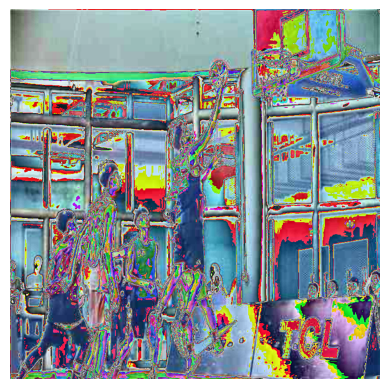

Transformed image size: 800 x 800
Scaled boxes: []


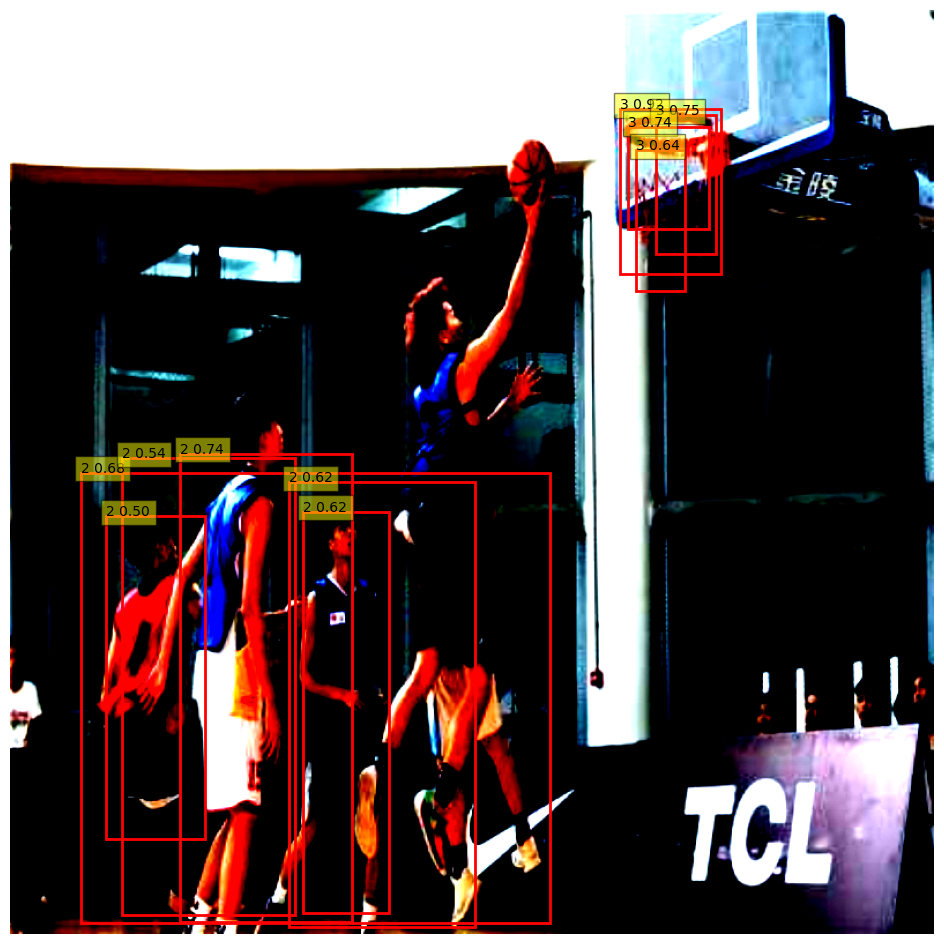

In [4]:
from going_modular.utils import CustomDataset
from torchvision import transforms as T
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import requests
import zipfile
from pathlib import Path
import os
import yaml
import cv2
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import matplotlib.patches as patches
from torchvision.transforms.functional import to_pil_image


# Load the saved model
def load_model(model_path, num_classes):
    model = fasterrcnn_resnet50_fpn(pretrained=False)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))
    model.eval()
    return model

def get_class_dict_from_yaml(file_path):
    # Check if the file exists
    if not os.path.exists(file_path):
        raise FileNotFoundError(f"The file {file_path} does not exist.")

    # Read the YAML file
    with open(file_path, 'r') as file:
        data = yaml.safe_load(file)

    # Extract class names and create a dictionary
    class_names = data.get('names', [])
    class_dict = {name: idx for idx, name in enumerate(class_names)}

    return class_dict

file_path = 'Basketball-2/data.yaml'
class_names_mapping = get_class_dict_from_yaml(file_path)
print(class_names_mapping)

# Setup path to data folder
data_path = Path("data/")
#image_path = data_path / "pizza_steak_sushi"
image_path = Path('Warriors-vs-Cavs-2016-10')
image_path = Path('Basketball-2')

test_images_dir = 'Basketball-2/test/images'
test_labels_dir = 'Basketball-2/test/labels'
train_images_dir = 'Basketball-2/train/images'
train_labels_dir = 'Basketball-2/train/labels'

# Function to draw predictions
def draw_predictions(image_tensor, predictions, threshold=0.5):
    image_tensor = image_tensor.cpu().clamp(0, 1)
    image_pil = to_pil_image(image_tensor)
    plt.figure(figsize=(12,12))
    plt.imshow(image_pil)
    ax = plt.gca()
    boxes = predictions["boxes"].cpu().detach().numpy()
    labels = predictions["labels"].cpu().detach().numpy()
    scores = predictions["scores"].cpu().detach().numpy()
    for box, label, score in zip(boxes, labels, scores):
        if score > threshold:
            xmin, ymin, xmax, ymax = box
            rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none')
            ax.add_patch(rect)
            plt.text(xmin, ymin, f'{label} {score:.2f}', bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

# Define your transformations
transform = T.Compose([
    T.Resize((800, 800)),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])


# Initialize your dataset
dataset = CustomDataset(img_dir=train_images_dir, 
                        label_dir=train_labels_dir, 
                        transform=transform, 
                        class_names_mapping=class_names_mapping)

# Path to your custom image
image_path = 'Basketball-2\\train\\images\\-2_jpg.rf.af8426c5a360fdbddeb3ef641a2e9b2d.jpg' 
#image_path = '15282699.jpg'
image_path = 'Basketball-2\\test\\images\\-09_jpg.rf.2544683796175f01527a4c4d0844d64d.jpg'

# Transform and scale the custom image
transformed_image, _ = dataset.transform_and_scale_single_image(image_path, debug=True)

# Convert the transformed image tensor to PIL Image for visualization
transformed_image_pil = T.ToPILImage()(transformed_image.squeeze(0))

# Display the transformed image
plt.imshow(transformed_image_pil)
plt.axis('off')
plt.show()

def predict_tensor(image_tensor, model, device):
    image_tensor = image_tensor.unsqueeze(0).to(device)

    model.eval()
    with torch.no_grad():
        predictions = model(image_tensor)[0]

    return image_tensor.squeeze(0), predictions

# Usage
model = load_model('best_model.pth', len(get_class_dict_from_yaml('Basketball-2/data.yaml')) + 1)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Usage for prediction on transformed image
transformed_image_tensor, _ = dataset.transform_and_scale_single_image(image_path, debug=True)
image, predictions = predict_tensor(transformed_image_tensor, model, device)
draw_predictions(image, predictions)


In [6]:
import cv2
from torchvision.transforms.functional import to_pil_image
from going_modular.utils import CustomDataset
from torchvision import transforms as T
import matplotlib.pyplot as plt
from PIL import Image
import requests
import zipfile
from pathlib import Path
import os
import yaml

def draw_predictions_on_frame(frame, predictions, class_names_mapping, threshold=0.5):
    for box, label, score in zip(predictions["boxes"], predictions["labels"], predictions["scores"]):
        if score > threshold:
            xmin, ymin, xmax, ymax = box.cpu().int().numpy()
            cv2.rectangle(frame, (xmin, ymin), (xmax, ymax), color=(255, 0, 0), thickness=2)
            label_name = class_names_mapping.get(label.item(), str(label.item()))
            cv2.putText(frame, f'{label_name} {score:.2f}', (xmin, ymin), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)


def process_video(video_path, model, device, dataset):
    cap = cv2.VideoCapture(video_path)

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Use the new method for transforming the frame
        transformed_frame = dataset.transform_and_scale_frame(frame)

        # Predict using the model
        prediction_tensor, predictions = predict_tensor(transformed_frame, model, device)

        # Convert the tensor back to PIL Image and then to OpenCV format
        pil_img = to_pil_image(prediction_tensor)
        cv_frame = cv2.cvtColor(np.array(pil_img), cv2.COLOR_RGB2BGR)

        # Draw the bounding boxes on the original frame
        draw_predictions_on_frame(cv_frame, predictions, dataset.class_map)

        cv2.imshow('Processed Frame', cv_frame)
        if cv2.waitKey(25) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()


output_path = 'data'
video_path = output_path + '\Warriors vs Cavaliers： Game 7 NBA Finals - 06.19.16 Full Highlights.mp4'

# Usage
process_video(video_path, model, device, dataset)
